# Volcano plot
- mode: HILICpos

In [1]:
# Let the middle rows included.
options(repr.matrix.max.rows=600, repr.matrix.max.cols=200)
# options(warn=-1)

In [2]:
# Load packages
library(dplyr)
library(ggplot2)

# Install ggrepel package if needed
# install.packages("devtools")
# devtools::install_github("slowkow/ggrepel")
library(ggrepel) #To be able to make ggplot without overlapping labeling
library(glue)


Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union




In [3]:
# Read data from the web
res_file_name = "../../output/hMinImp_TICnorm_groupFil0.3_RPneg_1wayANOVA/one_wayANOVA_hMinImp_TICnorm_groupFil0.3_RPneg_fullreport.csv"
annot_file_name = "../../../asari-output-RPneg/output_asari_project_32322133_wtStemCell/Feature_annotation.tsv"
res_df = read.table(res_file_name, row.names = 1,header=TRUE, sep = ',')

In [4]:
head(res_df)

,gMean_Tn,gMean_CD8stem,gMean_CD8trans,gMean_CD8TD,log2FC_CD8stemvsTn,log2FC_CD8transvsTn,log2FC_CD8TDvsTn,log2FC_CD8transvsCD8stem,log2FC_CD8TDvsCD8stem,log2FC_CD8TDvsCD8trans,f_score,pval,padj,Tpadj_CD8TD.CD8stem,Tpadj_CD8trans.CD8stem,Tpadj_Tn.CD8stem,Tpadj_CD8trans.CD8TD,Tpadj_Tn.CD8TD,Tpadj_Tn.CD8trans,TFDR_CD8TD.CD8stem,TFDR_CD8trans.CD8stem,TFDR_Tn.CD8stem,TFDR_CD8trans.CD8TD,TFDR_Tn.CD8TD,TFDR_Tn.CD8trans,CD8TD_750K_1,CD8TD_750K_2,CD8stem_250K_1,CD8stem_300K_2,CD8trans_250K_2,CD8trans_350K_1,Tn_250K_1,Tn_250K_2,pooled_1,pooled_2,pooled_3
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
F10,17.50701,18.11533,18.20446,17.70459,0.60832246,0.69745412,0.19758450,0.089131654,-0.4107380,-0.4998696,0.4806292,0.713238460,0.78297081,0.92488104,0.9990481,0.80749231,0.87741665,0.990074219,0.743669604,1.0000000,1,1,1.0000000,1.00000000,1.0000000,16.94364,18.46554,18.11010,18.12056,18.06150,18.34743,16.94364,18.07038,17.98012,18.11866,18.21712
F100,19.40004,17.42704,17.21097,16.79412,-1.97300335,-2.18906877,-2.60592325,-0.216065418,-0.6329199,-0.4168545,0.5446416,0.677487346,0.75960183,0.99071385,0.9996130,0.81190586,0.99726731,0.671148179,0.765295013,1.0000000,1,1,1.0000000,1.00000000,1.0000000,16.84709,16.74115,19.66737,15.18671,19.23523,15.18671,20.25563,18.54446,17.84755,16.85690,15.18671
F1000,18.70738,18.72188,18.73066,19.12033,0.01449614,0.02327323,0.41294557,0.008777088,0.3984494,0.3896723,11.4125828,0.019787965,0.13076606,0.03005019,0.9995202,0.99786490,0.03239841,0.026604471,0.991428312,0.2560623,1,1,0.2843019,0.19350154,1.0000000,19.17408,19.06658,18.63766,18.80609,18.73182,18.72949,18.77137,18.64340,18.57825,18.47179,18.43940
F10000,19.76419,18.80072,18.96675,19.30923,-0.96347825,-0.79744206,-0.45496395,0.166036192,0.5085143,0.3424781,0.1882932,0.899254650,0.92089343,0.98093339,0.9992834,0.89437723,0.99389821,0.986113010,0.934689461,1.0000000,1,1,1.0000000,1.00000000,1.0000000,20.68696,17.93150,19.66993,17.93150,20.00200,17.93150,19.41160,20.11679,19.19175,17.93150,18.92166
F10004,24.21570,24.15581,24.09963,24.28254,-0.05988750,-0.11607349,0.06683994,-0.056185992,0.1267274,0.1829134,0.1232617,0.941582413,0.95531191,0.97559516,0.9976924,0.99721339,0.93388653,0.996147793,0.980943939,1.0000000,1,1,1.0000000,1.00000000,1.0000000,24.34201,24.22307,24.45196,23.85966,24.42813,23.77112,24.25452,24.17688,23.94397,24.22769,24.37852
F10005,17.96977,19.69944,20.49473,21.21931,1.72967010,2.52495339,3.24953895,0.795283298,1.5198688,0.7245856,27.2914255,0.004004406,0.06292029,0.05200933,0.2911744,0.03405868,0.34860417,0.003497835,0.008977772,0.3178667,1,1,0.8783993,0.08093424,0.5412314,21.18068,21.25794,19.55351,19.84537,20.95677,20.03268,17.74737,18.19217,18.94083,18.92075,19.62918


-------

-------

-------

## Create output directory

In [5]:
out_dir = "../../output/hMinImp_TICnorm_groupFil0.3_RPneg_1wayANOVA/volcano_plot/"
dir.create(out_dir)

In [6]:
head(res_df,2)

,gMean_Tn,gMean_CD8stem,gMean_CD8trans,gMean_CD8TD,log2FC_CD8stemvsTn,log2FC_CD8transvsTn,log2FC_CD8TDvsTn,log2FC_CD8transvsCD8stem,log2FC_CD8TDvsCD8stem,log2FC_CD8TDvsCD8trans,f_score,pval,padj,Tpadj_CD8TD.CD8stem,Tpadj_CD8trans.CD8stem,Tpadj_Tn.CD8stem,Tpadj_CD8trans.CD8TD,Tpadj_Tn.CD8TD,Tpadj_Tn.CD8trans,TFDR_CD8TD.CD8stem,TFDR_CD8trans.CD8stem,TFDR_Tn.CD8stem,TFDR_CD8trans.CD8TD,TFDR_Tn.CD8TD,TFDR_Tn.CD8trans,CD8TD_750K_1,CD8TD_750K_2,CD8stem_250K_1,CD8stem_300K_2,CD8trans_250K_2,CD8trans_350K_1,Tn_250K_1,Tn_250K_2,pooled_1,pooled_2,pooled_3
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
F10,17.50701,18.11533,18.20446,17.70459,0.6083225,0.6974541,0.1975845,0.08913165,-0.4107380,-0.4998696,0.4806292,0.7132385,0.7829708,0.9248810,0.9990481,0.8074923,0.8774167,0.9900742,0.7436696,1,1,1,1,1,1,16.94364,18.46554,18.11010,18.12056,18.06150,18.34743,16.94364,18.07038,17.98012,18.11866,18.21712
F100,19.40004,17.42704,17.21097,16.79412,-1.9730034,-2.1890688,-2.6059233,-0.21606542,-0.6329199,-0.4168545,0.5446416,0.6774873,0.7596018,0.9907139,0.9996130,0.8119059,0.9972673,0.6711482,0.7652950,1,1,1,1,1,1,16.84709,16.74115,19.66737,15.18671,19.23523,15.18671,20.25563,18.54446,17.84755,16.85690,15.18671


------

------

------

# Volcano plot function

In [7]:
volcano_plot <- function(res_df = res_df,
                            padj_colname = padj_colname,
                            log2FC_colname = log2FC_colname,
                            p_cut_off = p_cut_off,
                            log2FC_cut_off = log2FC_cut_off,
                            xlab = xlab,
                            ylab = '-log10(adj. p-val)',
                            xlim = xlim,
                            ylim = ylim,
                            highlight_text = FALSE,
                            fig_width = 8,
                            fig_height = 8,
                            text_size = 20,
                            legend_size = 20,
                            axis_title_size = 20,
                            output_dir = "",
                            pdf_prefix = 'test',
                            show_plot = TRUE) {
    
    colnames(res_df)
    res_df = mutate(res_df, 
                     Label = ifelse((res_df[,padj_colname] < p_cut_off) & (abs(res_df[,log2FC_colname]) > 1),  # Label is the column that distinguish the coloring
                                  "Significant", 
                                  "Not Sign.")) #mutate is a good function 

    res_df$log10padj = -log(res_df[,padj_colname],10)
    print(paste0("range of log10padj: ", range(res_df$log10padj),'\n', "range of log2FC: ", range(res_df$log2FC)))
    
    options(repr.plot.width = fig_width, repr.plot.height = fig_height)
    
    hist(res_df[,log2FC_colname], breaks =30)
    
    p = ggplot( res_df, 
                aes_string(log2FC_colname,"log10padj")) +
                geom_point(aes(col=Label), alpha = 0.5) +
                scale_color_manual(values=c("#888888","#ff0000")) +
                xlim(xlim) + 
                ylim(ylim) + 
                xlab(xlab) +
                ylab(ylab) +
                
                theme(
                      panel.grid.major = element_line(colour = "grey50",linetype = "dashed", size = 0.2),
                      panel.border = element_rect(fill = NA),
                      #panel.grid.minor = element_blank(),
                      panel.background = element_rect(fill = "transparent",colour = NA),
                      plot.background = element_rect(fill = "transparent",colour = NA),
                      axis.text = element_text(size = text_size, colour="black"),
                      axis.text.x = element_text(colour="black"),
                      legend.text= element_text(size = legend_size),
                      legend.title = element_text(size = legend_size),
                      axis.title = element_text(size = axis_title_size)
                    )
    if(highlight_text == TRUE) {
        print("With highlighted text")
        p = p + geom_text_repel(data = filter(res_df, highlight != ""), 
                                aes(label = highlight),
                                max.overlaps = Inf)
    }
    
    if (show_plot == TRUE) {
        print(p) # display the plot
    } else {return(p)}

    if (length(output_dir)!=0) {
            ggsave(file.path(output_dir, 
                             glue("volcano_plot_",
                                                pdf_prefix,".pdf")), 
                   width = fig_width, 
                   height = fig_height)
        }
}

select_topN2present <- function(res_df, annot_df, topN, padj_label) {
    res_df = res_df %>% arrange_(padj_colname) 
    featIDs = rownames(res_df[1:topN,])
    annot_list = list()
    res_df['highlight'] = ""
    for (featID in featIDs) {
        res_df[featID,'highlight'] = annot_df[annot_df['X.peak.id_number']==featID,'name_1st_guess'][1]
    }
    
    return(res_df)
}

------

# Volcano plot
## log2FC CD8TD vs. CD8stem

In [8]:
colnames(res_df)

[1] "gMean_Tn"                 "gMean_CD8stem"           
 [3] "gMean_CD8trans"           "gMean_CD8TD"             
 [5] "log2FC_CD8stemvsTn"       "log2FC_CD8transvsTn"     
 [7] "log2FC_CD8TDvsTn"         "log2FC_CD8transvsCD8stem"
 [9] "log2FC_CD8TDvsCD8stem"    "log2FC_CD8TDvsCD8trans"  
[11] "f_score"                  "pval"                    
[13] "padj"                     "Tpadj_CD8TD.CD8stem"     
[15] "Tpadj_CD8trans.CD8stem"   "Tpadj_Tn.CD8stem"        
[17] "Tpadj_CD8trans.CD8TD"     "Tpadj_Tn.CD8TD"          
[19] "Tpadj_Tn.CD8trans"        "TFDR_CD8TD.CD8stem"      
[21] "TFDR_CD8trans.CD8stem"    "TFDR_Tn.CD8stem"         
[23] "TFDR_CD8trans.CD8TD"      "TFDR_Tn.CD8TD"           
[25] "TFDR_Tn.CD8trans"         "CD8TD_750K_1"            
[27] "CD8TD_750K_2"             "CD8stem_250K_1"          
[29] "CD8stem_300K_2"           "CD8trans_250K_2"         
[31] "CD8trans_350K_1"          "Tn_250K_1"               
[33] "Tn_250K_2"                "pooled_1"                
[35] "pooled_2"                 "pooled_3"

In [9]:
padj_colname = 'Tpadj_CD8TD.CD8stem'
log2FC_colname = 'log2FC_CD8TDvsCD8stem'
contrast = "CD8TD vs. CD8stem"

### No highlight

Warning message in min(x, na.rm = na.rm):
“no non-missing arguments to min; returning Inf”
Warning message in max(x, na.rm = na.rm):
“no non-missing arguments to max; returning -Inf”


[1] "range of log10padj: 0\nrange of log2FC: Inf"                
[2] "range of log10padj: 13.0282473235653\nrange of log2FC: -Inf"


Warning message:
“`aes_string()` was deprecated in ggplot2 3.0.0.
ℹ Please use tidy evaluation ideoms with `aes()`”
Warning message:
“The `size` argument of `element_line()` is deprecated as of ggplot2 3.4.0.
ℹ Please use the `linewidth` argument instead.”
Warning message:
“Removed 15 rows containing missing values (`geom_point()`).”
Warning message:
“Removed 15 rows containing missing values (`geom_point()`).”


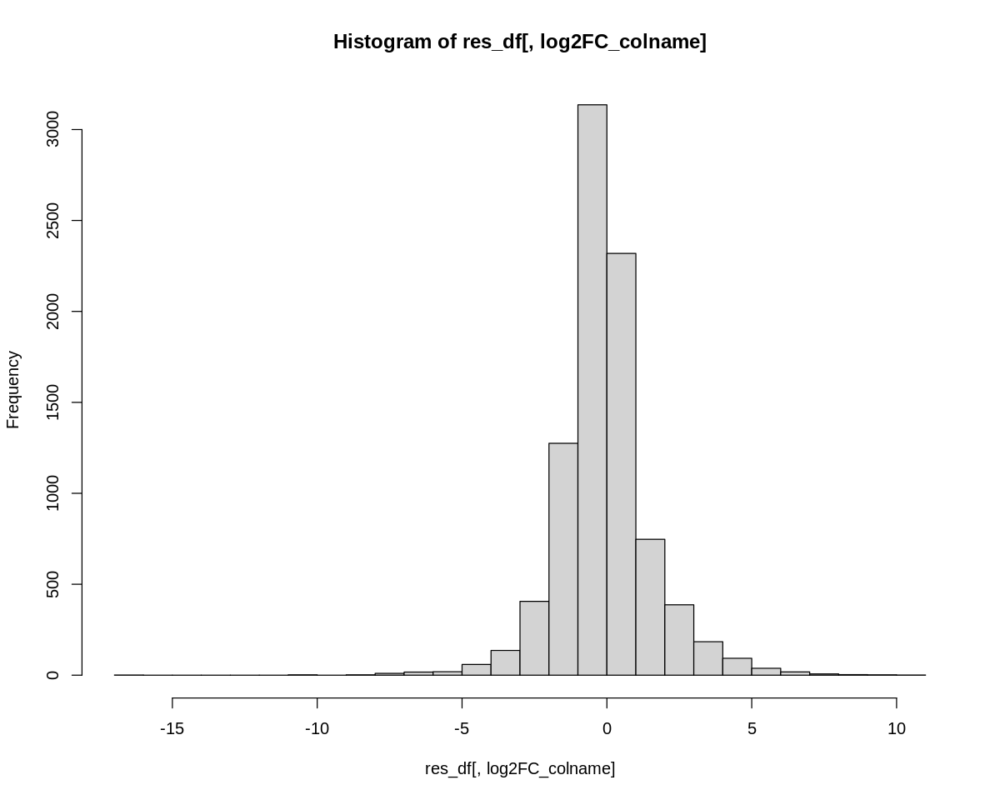

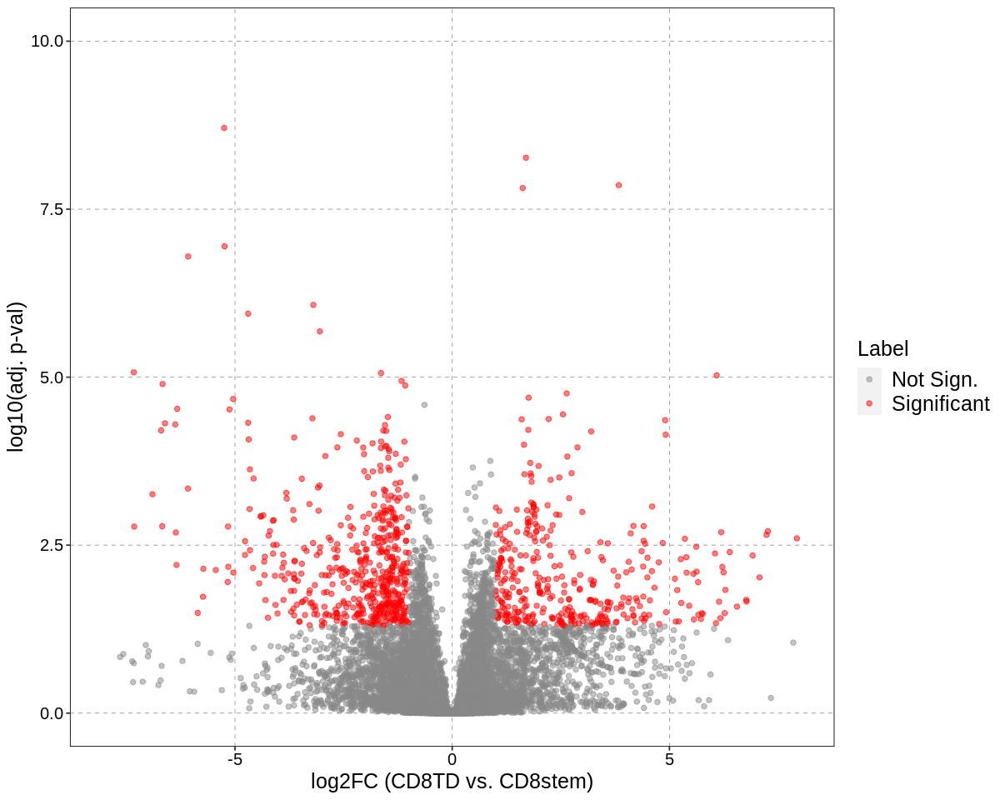

In [10]:
volcano_plot(res_df = res_df,
                padj_colname = padj_colname,
                log2FC_colname = log2FC_colname,
                p_cut_off = 0.05,
                log2FC_cut_off = 1,
                xlab = glue("log2FC ({contrast})"),
                ylab = 'log10(adj. p-val)',
                xlim = c(-8,8),
                ylim = c(0,10),
                highlight = FALSE,
                fig_width = 10,
                fig_height = 8,
                text_size = 12,
                legend_size = 15,
                axis_title_size = 15,
                output_dir = out_dir,
                pdf_prefix = glue('{contrast}'),
                show_plot = TRUE)

## With highlight

### Select parameters for highlight

In [12]:
want2annotate_feature_name = TRUE
topN = 200

In [13]:
if(want2annotate_feature_name) {
    annot_df = read.csv(annot_file_name, sep = '\t') #somehow only dplyr read.csv works 
    res_df = select_topN2present(res_df, annot_df, topN)
}

Warning message:
“`arrange_()` was deprecated in dplyr 0.7.0.
ℹ Please use `arrange()` instead.
ℹ See vignette('programming') for more help”


In [14]:
unique(res_df$highlight)

[1] ""                                                           
 [2] "PE(18:3(6Z,9Z,12Z)/P-18:1(11Z))"                            
 [3] "Germanicol cinnamate"                                       
 [4] "PS(18:1(11Z)/24:1(15Z))"                                    
 [5] "PC(15:0/18:4(6Z,9Z,12Z,15Z))"                               
 [6] "PA(18:1(11Z)/22:2(13Z,16Z))"                                
 [7] "Valsartan"                                                  
 [8] "PE(P-16:0/22:6(4Z,7Z,10Z,13Z,16Z,19Z))"                     
 [9] "Cer(d18:1/18:0)"                                            
[10] "PG(18:0/18:2(9Z,12Z))"                                      
[11] "Cerebroside B"                                              
[12] "PI(16:0/22:4(10Z,13Z,16Z,19Z))"                             
[13] "PI(16:0/18:1(11Z))"                                         
[14] "26-Glucosyl-1,3,11,22-tetrahydroxyergosta-5,24-dien-26-oate"
[15] "PC(15:0/20:5(5Z,8Z,11Z,14Z,17Z))"                           
[16] "Austalide J"                                                
[17] "SM(d18:1/16:0)"                                             
[18] "PE(P-18:0/20:4(5Z,8Z,11Z,14Z))"                             
[19] "LysoPA(0:0/16:0)"

Warning message in min(x, na.rm = na.rm):
“no non-missing arguments to min; returning Inf”
Warning message in max(x, na.rm = na.rm):
“no non-missing arguments to max; returning -Inf”


[1] "range of log10padj: 0\nrange of log2FC: Inf"                
[2] "range of log10padj: 13.0282473235653\nrange of log2FC: -Inf"
[1] "With highlighted text"


Warning message:
“Removed 15 rows containing missing values (`geom_point()`).”
Warning message:
“Removed 4 rows containing missing values (`geom_text_repel()`).”
Warning message:
“Removed 15 rows containing missing values (`geom_point()`).”
Warning message:
“Removed 4 rows containing missing values (`geom_text_repel()`).”


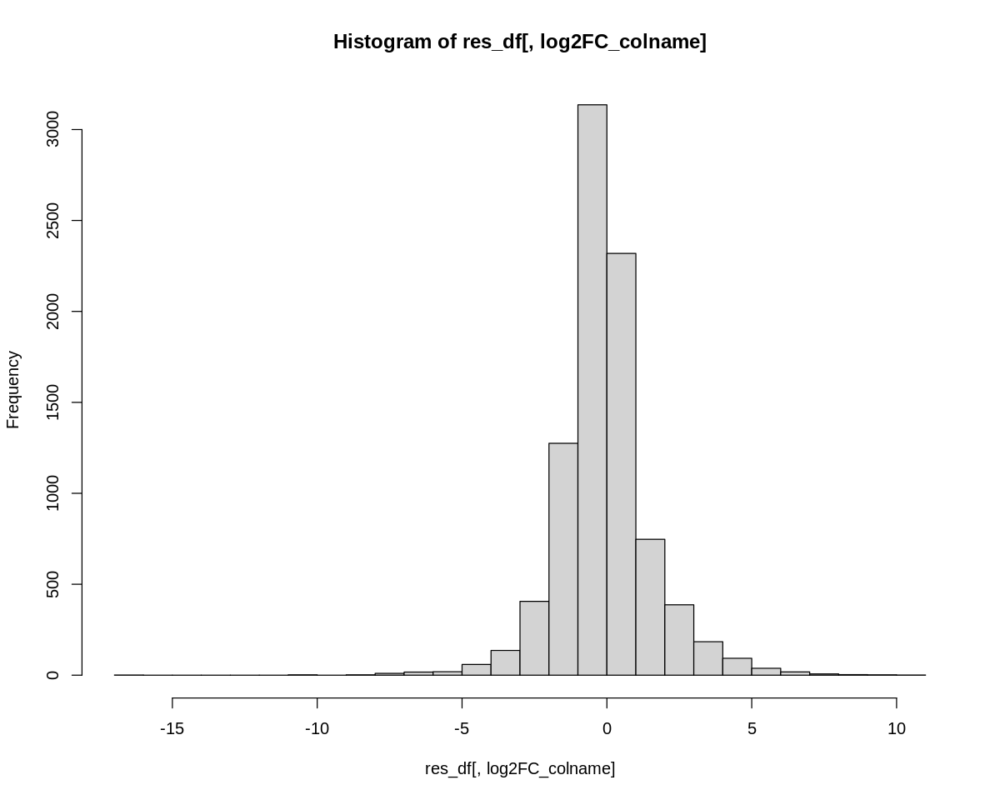

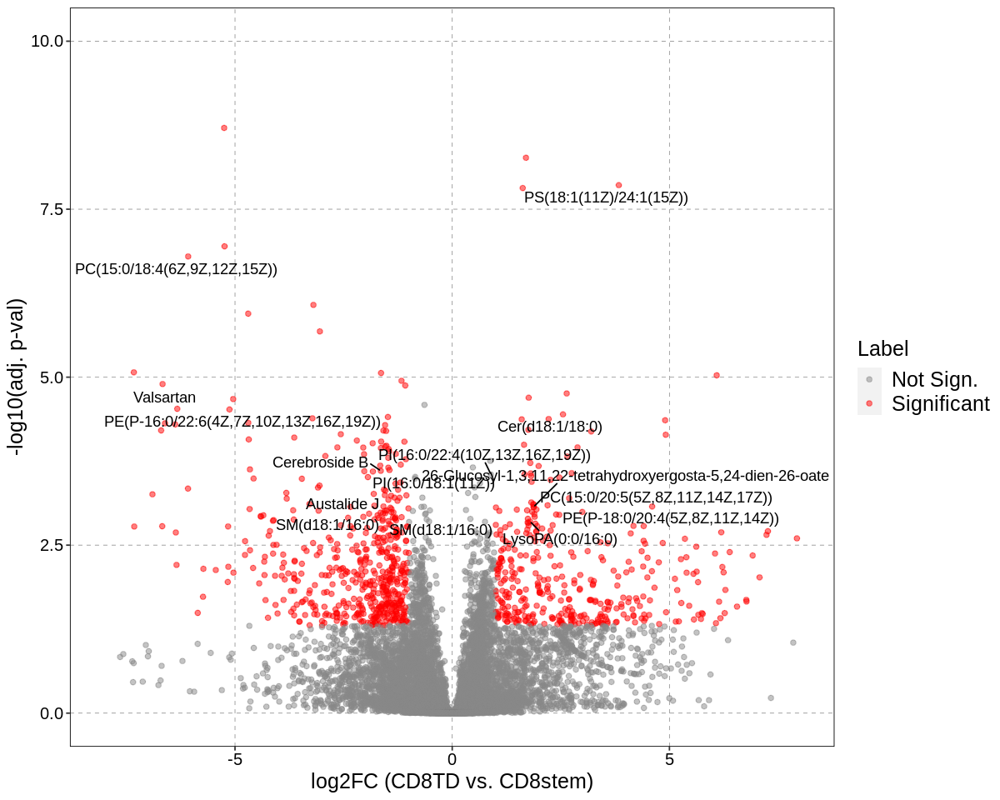

In [15]:
volcano_plot(   res_df = res_df,
                padj_colname = padj_colname,
                log2FC_colname = log2FC_colname,
                p_cut_off = 0.05,
                log2FC_cut_off = 1,
                xlab = glue("log2FC ({contrast})"),
                ylab = '-log10(adj. p-val)',
                xlim = c(-8,8),
                ylim = c(0,10),
                highlight_text = TRUE,
                fig_width = 10,
                fig_height = 8,
                text_size = 12,
                legend_size = 15,
                axis_title_size = 15,
                output_dir = out_dir,
                pdf_prefix = glue('{contrast}_with_highlight{topN}'),
                show_plot = TRUE)

--------

------

# Volcano plot
## log2FC CD8TD vs. Tn

In [16]:
colnames(res_df)[grep("Tpadj",colnames(res_df))]

[1] "Tpadj_CD8TD.CD8stem"    "Tpadj_CD8trans.CD8stem" "Tpadj_Tn.CD8stem"      
[4] "Tpadj_CD8trans.CD8TD"   "Tpadj_Tn.CD8TD"         "Tpadj_Tn.CD8trans"

In [17]:
colnames(res_df)[grep("log2FC",colnames(res_df))]

[1] "log2FC_CD8stemvsTn"       "log2FC_CD8transvsTn"     
[3] "log2FC_CD8TDvsTn"         "log2FC_CD8transvsCD8stem"
[5] "log2FC_CD8TDvsCD8stem"    "log2FC_CD8TDvsCD8trans"

In [18]:
padj_colname = 'Tpadj_Tn.CD8TD'
log2FC_colname = 'log2FC_CD8TDvsTn'
contrast = "CD8TD vs. Tn"

### No highlight

Warning message in min(x, na.rm = na.rm):
“no non-missing arguments to min; returning Inf”
Warning message in max(x, na.rm = na.rm):
“no non-missing arguments to max; returning -Inf”


[1] "range of log10padj: 0\nrange of log2FC: Inf"                
[2] "range of log10padj: 13.0282473235653\nrange of log2FC: -Inf"


Warning message:
“Removed 22 rows containing missing values (`geom_point()`).”
Warning message:
“Removed 22 rows containing missing values (`geom_point()`).”


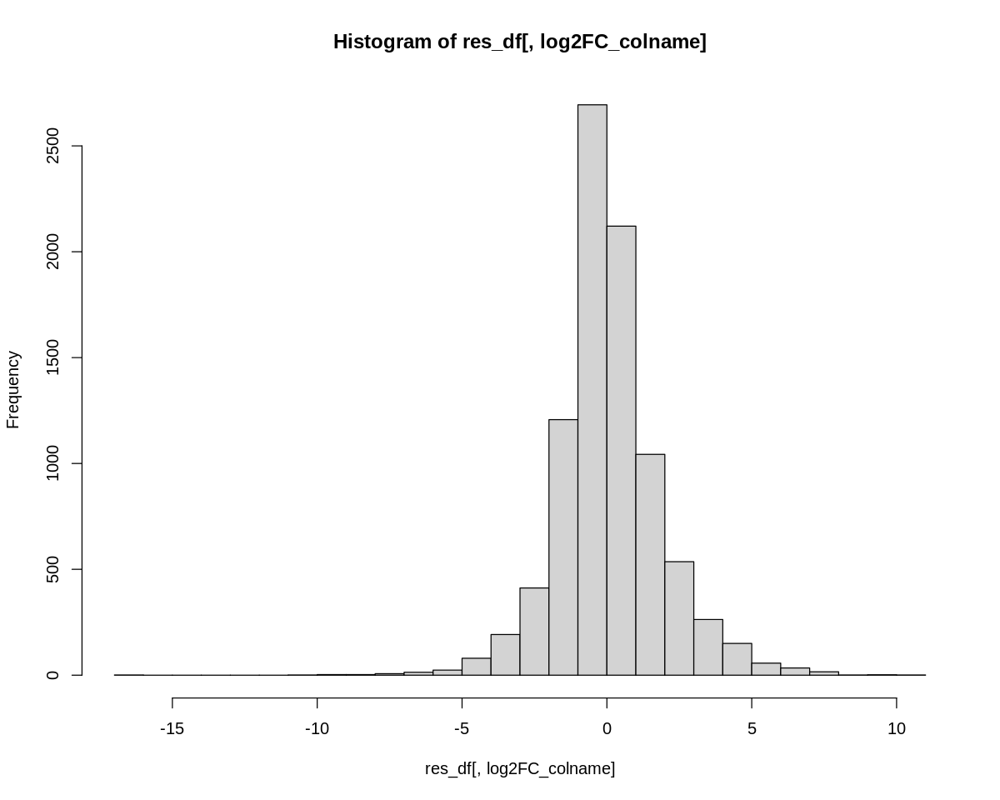

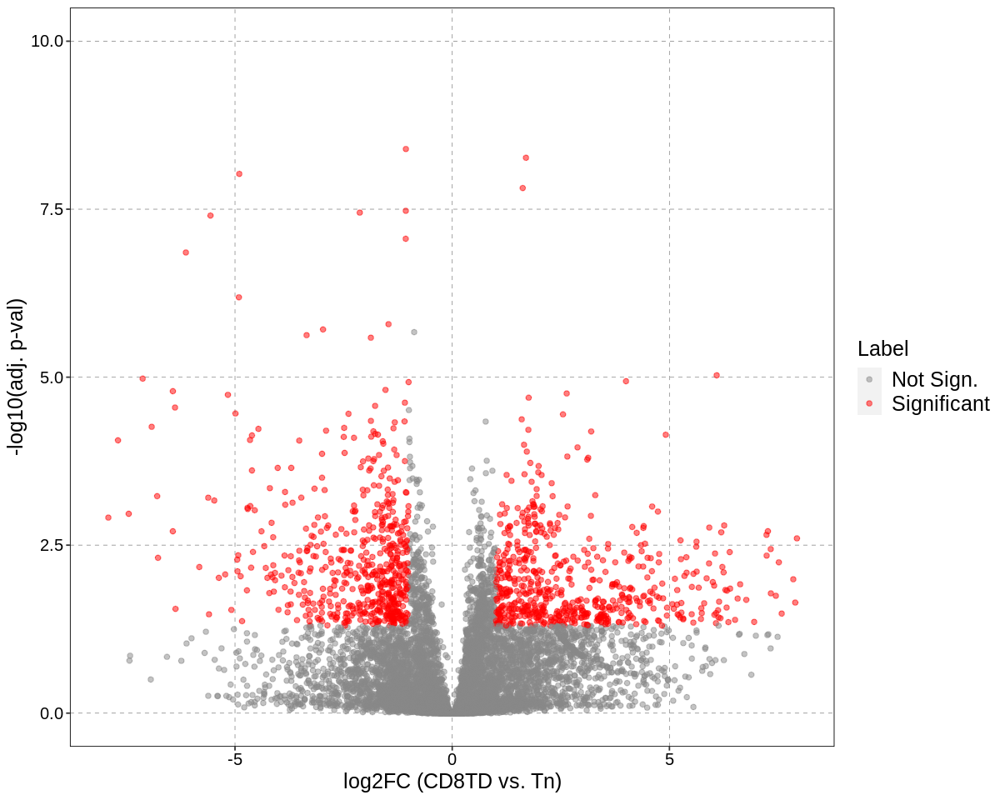

In [19]:
volcano_plot(res_df = res_df,
                padj_colname = padj_colname,
                log2FC_colname = log2FC_colname,
                p_cut_off = 0.05,
                log2FC_cut_off = 1,
                xlab = glue("log2FC ({contrast})"),
                ylab = '-log10(adj. p-val)',
                xlim = c(-8,8),
                ylim = c(0,10),
                highlight = FALSE,
                fig_width = 10,
                fig_height = 8,
                text_size = 12,
                legend_size = 15,
                axis_title_size = 15,
                output_dir = out_dir,
                pdf_prefix = glue('{contrast}'),
                show_plot = TRUE)

## With highlight

### Select parameters for highlight

In [20]:
if(want2annotate_feature_name) {
    annot_df = read.csv(annot_file_name, sep = '\t') #somehow only dplyr read.csv works 
    res_df = select_topN2present(res_df, annot_df, topN)
}

Warning message:
“`arrange_()` was deprecated in dplyr 0.7.0.
ℹ Please use `arrange()` instead.
ℹ See vignette('programming') for more help”


In [21]:
want2annotate_feature_name = TRUE
topN = 200

In [22]:
unique(res_df$highlight)

[1] ""                                                                               
 [2] "PE(18:3(6Z,9Z,12Z)/P-18:1(11Z))"                                                
 [3] "Germanicol cinnamate"                                                           
 [4] "PC(15:0/18:4(6Z,9Z,12Z,15Z))"                                                   
 [5] "PA(18:1(11Z)/22:2(13Z,16Z))"                                                    
 [6] "PI(16:0/18:1(11Z))"                                                             
 [7] "Valsartan"                                                                      
 [8] "PE(P-16:0/22:6(4Z,7Z,10Z,13Z,16Z,19Z))"                                         
 [9] "Cer(d18:1/18:0)"                                                                
[10] "PG(18:0/18:2(9Z,12Z))"                                                          
[11] "Cerebroside B"                                                                  
[12] "Garciduol C"                                                                    
[13] "PI(16:0/22:4(10Z,13Z,16Z,19Z))"                                                 
[14] "(3b,16a,20R)-25-Acetoxy-3,16,20,22-tetrahydroxy-5-cucurbiten-11-one 3-glucoside"
[15] "PI(18:0/22:4(10Z,13Z,16Z,19Z))"                                                 
[16] "PC(15:0/18:2(9Z,12Z))"                                                          
[17] "PE(18:1(11Z)/22:6(4Z,7Z,10Z,13Z,16Z,19Z))"                                      
[18] "PC(15:0/22:6(4Z,7Z,10Z,13Z,16Z,19Z))"                                           
[19] "Austalide J"                                                                    
[20] "26-Glucosyl-1,3,11,22-tetrahydroxyergosta-5,24-dien-26-oate"                    
[21] "SM(d18:1/16:0)"                                                                 
[22] "PE(16:0/22:6(4Z,7Z,10Z,13Z,16Z,19Z))"

Warning message in min(x, na.rm = na.rm):
“no non-missing arguments to min; returning Inf”
Warning message in max(x, na.rm = na.rm):
“no non-missing arguments to max; returning -Inf”


[1] "range of log10padj: 0\nrange of log2FC: Inf"                
[2] "range of log10padj: 13.0282473235653\nrange of log2FC: -Inf"
[1] "With highlighted text"


Warning message:
“Removed 22 rows containing missing values (`geom_point()`).”
Warning message:
“Removed 3 rows containing missing values (`geom_text_repel()`).”
Warning message:
“Removed 22 rows containing missing values (`geom_point()`).”
Warning message:
“Removed 3 rows containing missing values (`geom_text_repel()`).”


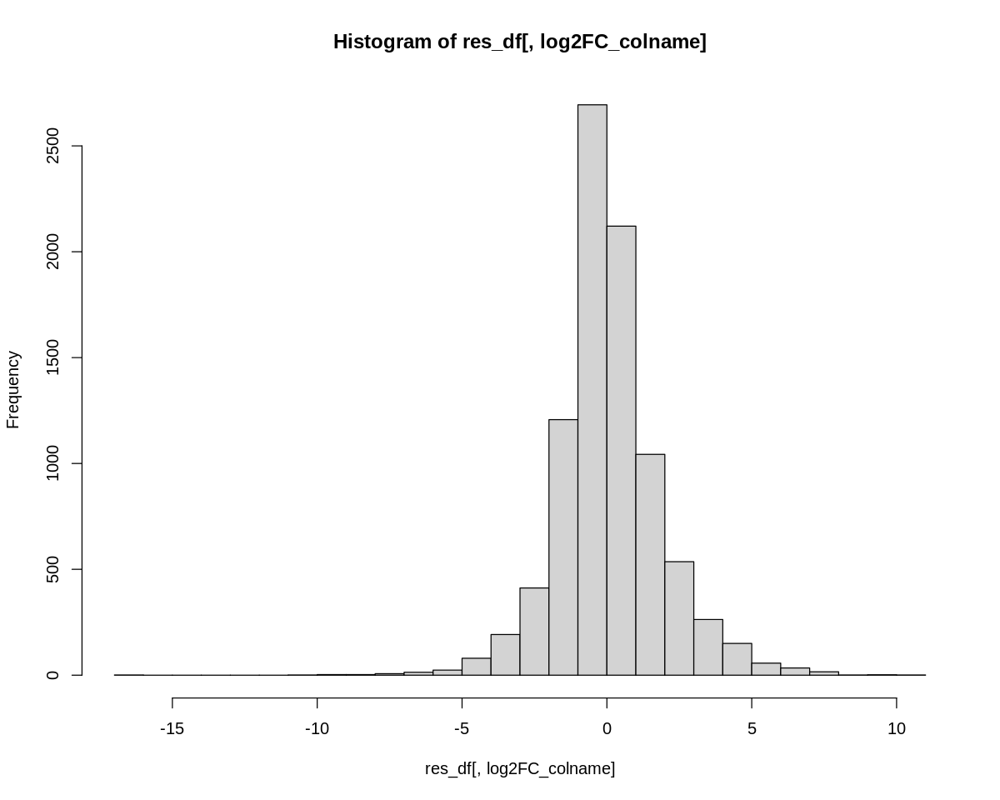

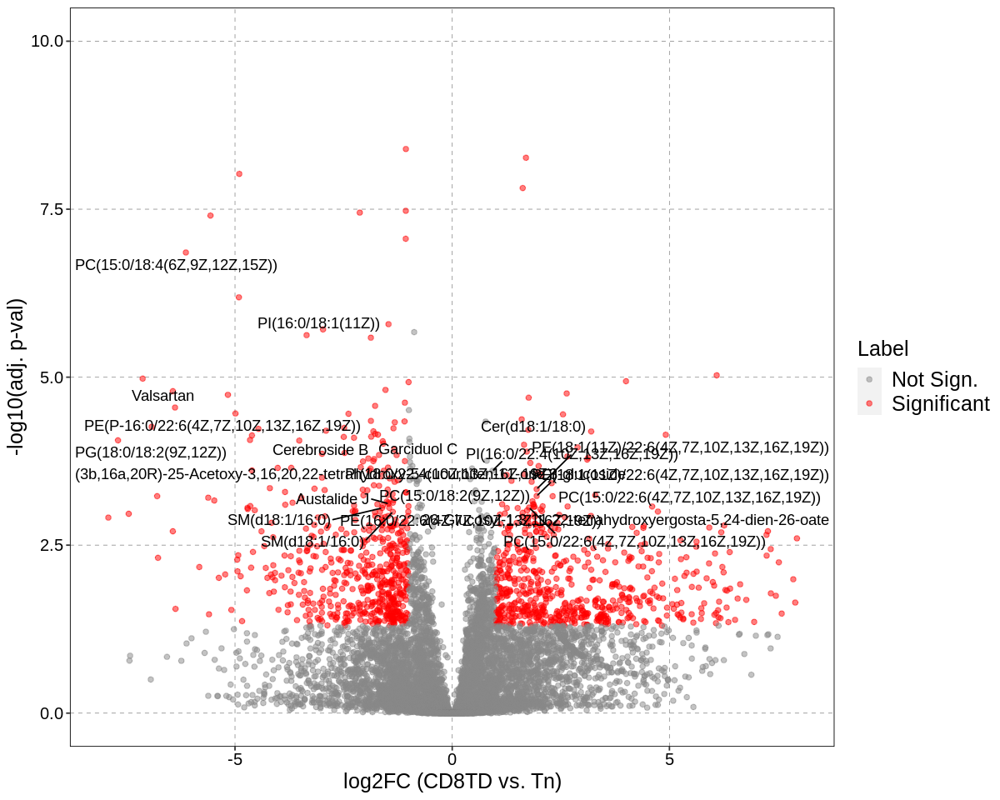

In [23]:
volcano_plot(   res_df = res_df,
                padj_colname = padj_colname,
                log2FC_colname = log2FC_colname,
                p_cut_off = 0.05,
                log2FC_cut_off = 1,
                xlab = glue("log2FC ({contrast})"),
                ylab = '-log10(adj. p-val)',
                xlim = c(-8,8),
                ylim = c(0,10),
                highlight_text = TRUE,
                fig_width = 10,
                fig_height = 8,
                text_size = 12,
                legend_size = 15,
                axis_title_size = 15,
                output_dir = out_dir,
                pdf_prefix = glue('{contrast}_with_highlight{topN}'),
                show_plot = TRUE)

-----

-----

-----

# Volcano plot
## log2FC CD8TD vs. Tn

In [24]:
colnames(res_df)[grep("Tpadj",colnames(res_df))]

[1] "Tpadj_CD8TD.CD8stem"    "Tpadj_CD8trans.CD8stem" "Tpadj_Tn.CD8stem"      
[4] "Tpadj_CD8trans.CD8TD"   "Tpadj_Tn.CD8TD"         "Tpadj_Tn.CD8trans"

In [25]:
colnames(res_df)[grep("log2FC",colnames(res_df))]

[1] "log2FC_CD8stemvsTn"       "log2FC_CD8transvsTn"     
[3] "log2FC_CD8TDvsTn"         "log2FC_CD8transvsCD8stem"
[5] "log2FC_CD8TDvsCD8stem"    "log2FC_CD8TDvsCD8trans"

In [26]:
padj_colname = 'Tpadj_CD8trans.CD8TD'
log2FC_colname = 'log2FC_CD8TDvsCD8trans'
contrast = "CD8TD vs. CD8trans"

### With highlight

### Select parameters for highlight

In [27]:
if(want2annotate_feature_name) {
    annot_df = read.csv(annot_file_name, sep = '\t') #somehow only dplyr read.csv works 
    res_df = select_topN2present(res_df, annot_df, topN)
}

Warning message:
“`arrange_()` was deprecated in dplyr 0.7.0.
ℹ Please use `arrange()` instead.
ℹ See vignette('programming') for more help”


In [28]:
want2annotate_feature_name = TRUE
topN = 200

In [29]:
unique(res_df$highlight)

[1] ""                                                                               
 [2] "PE(18:3(6Z,9Z,12Z)/P-18:1(11Z))"                                                
 [3] "Germanicol cinnamate"                                                           
 [4] "PS(18:1(11Z)/24:1(15Z))"                                                        
 [5] "PC(15:0/18:4(6Z,9Z,12Z,15Z))"                                                   
 [6] "PA(18:1(11Z)/22:2(13Z,16Z))"                                                    
 [7] "Valsartan"                                                                      
 [8] "PE(P-16:0/22:6(4Z,7Z,10Z,13Z,16Z,19Z))"                                         
 [9] "Cer(d18:1/18:0)"                                                                
[10] "PG(18:0/18:2(9Z,12Z))"                                                          
[11] "PI(16:0/22:4(10Z,13Z,16Z,19Z))"                                                 
[12] "Cerebroside B"                                                                  
[13] "Austalide J"                                                                    
[14] "26-Glucosyl-1,3,11,22-tetrahydroxyergosta-5,24-dien-26-oate"                    
[15] "PC(15:0/20:5(5Z,8Z,11Z,14Z,17Z))"                                               
[16] "Angiotensin III"                                                                
[17] "SM(d18:1/16:0)"                                                                 
[18] "PC(15:0/18:2(9Z,12Z))"                                                          
[19] "(3b,16a,20R)-25-Acetoxy-3,16,20,22-tetrahydroxy-5-cucurbiten-11-one 3-glucoside"
[20] "SM(d18:1/14:0)"                                                                 
[21] "DG(14:0/0:0/18:3n6)"

Warning message in min(x, na.rm = na.rm):
“no non-missing arguments to min; returning Inf”
Warning message in max(x, na.rm = na.rm):
“no non-missing arguments to max; returning -Inf”


[1] "range of log10padj: 0\nrange of log2FC: Inf"                
[2] "range of log10padj: 13.0282473235653\nrange of log2FC: -Inf"
[1] "With highlighted text"


Warning message:
“Removed 14 rows containing missing values (`geom_point()`).”
Warning message:
“Removed 3 rows containing missing values (`geom_text_repel()`).”
Warning message:
“Removed 14 rows containing missing values (`geom_point()`).”
Warning message:
“Removed 3 rows containing missing values (`geom_text_repel()`).”


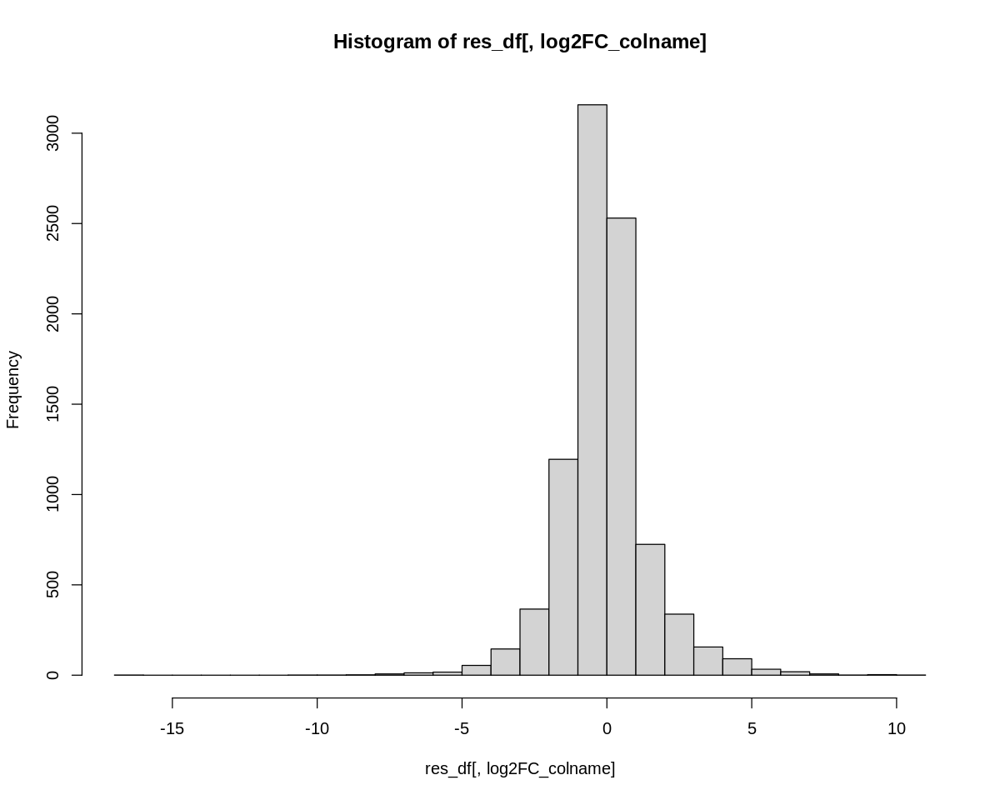

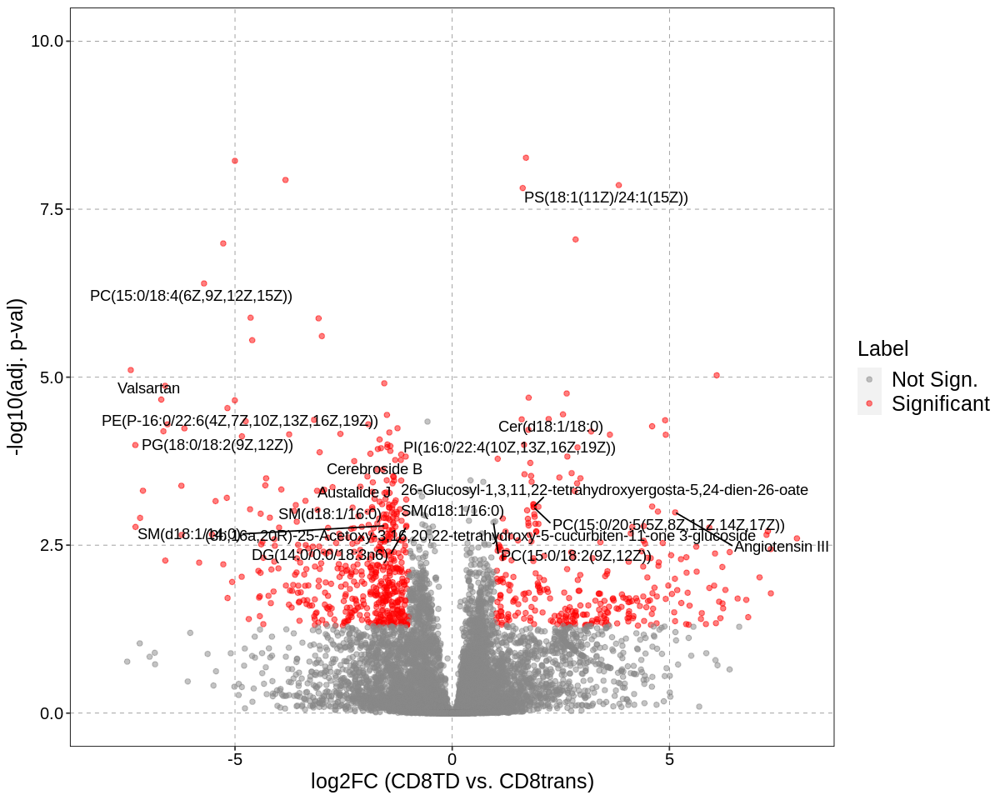

In [30]:
volcano_plot(   res_df = res_df,
                padj_colname = padj_colname,
                log2FC_colname = log2FC_colname,
                p_cut_off = 0.05,
                log2FC_cut_off = 1,
                xlab = glue("log2FC ({contrast})"),
                ylab = '-log10(adj. p-val)',
                xlim = c(-8,8),
                ylim = c(0,10),
                highlight_text = TRUE,
                fig_width = 10,
                fig_height = 8,
                text_size = 12,
                legend_size = 15,
                axis_title_size = 15,
                output_dir = out_dir,
                pdf_prefix = glue('{contrast}_with_highlight{topN}'),
                show_plot = TRUE)

-----

-----

-----

# Volcano plot
## log2FC CD8trans vs. Tn

In [31]:
colnames(res_df)[grep("Tpadj",colnames(res_df))]

[1] "Tpadj_CD8TD.CD8stem"    "Tpadj_CD8trans.CD8stem" "Tpadj_Tn.CD8stem"      
[4] "Tpadj_CD8trans.CD8TD"   "Tpadj_Tn.CD8TD"         "Tpadj_Tn.CD8trans"

In [32]:
colnames(res_df)[grep("log2FC",colnames(res_df))]

[1] "log2FC_CD8stemvsTn"       "log2FC_CD8transvsTn"     
[3] "log2FC_CD8TDvsTn"         "log2FC_CD8transvsCD8stem"
[5] "log2FC_CD8TDvsCD8stem"    "log2FC_CD8TDvsCD8trans"

In [33]:
padj_colname = 'Tpadj_Tn.CD8trans'
log2FC_colname = 'log2FC_CD8transvsTn'
contrast = "CD8trans vs. Tn"

### With highlight

### Select parameters for highlight

In [34]:
if(want2annotate_feature_name) {
    annot_df = read.csv(annot_file_name, sep = '\t') #somehow only dplyr read.csv works 
    res_df = select_topN2present(res_df, annot_df, topN)
}

Warning message:
“`arrange_()` was deprecated in dplyr 0.7.0.
ℹ Please use `arrange()` instead.
ℹ See vignette('programming') for more help”


In [35]:
want2annotate_feature_name = TRUE
topN = 200

In [36]:
unique(res_df$highlight)

[1] ""                                                                               
 [2] "PS(18:1(11Z)/24:1(15Z))"                                                        
 [3] "PI(16:0/18:1(11Z))"                                                             
 [4] "Garciduol C"                                                                    
 [5] "Angiotensin III"                                                                
 [6] "PI(18:0/22:4(10Z,13Z,16Z,19Z))"                                                 
 [7] "Eplerenone"                                                                     
 [8] "PC(15:0/20:5(5Z,8Z,11Z,14Z,17Z))"                                               
 [9] "Cer(d18:1/16:0)"                                                                
[10] "PE(18:1(11Z)/22:6(4Z,7Z,10Z,13Z,16Z,19Z))"                                      
[11] "PE(P-18:0/20:4(5Z,8Z,11Z,14Z))"                                                 
[12] "PC(15:0/22:6(4Z,7Z,10Z,13Z,16Z,19Z))"                                           
[13] "Ceanothine B"                                                                   
[14] "Cinitapride"                                                                    
[15] "PS(20:5(5Z,8Z,11Z,14Z,17Z)/24:1(15Z))"                                          
[16] "Osmanthuside A"                                                                 
[17] "Thymidine 5'-triphosphate"                                                      
[18] "(3b,16a,20R)-25-Acetoxy-3,16,20,22-tetrahydroxy-5-cucurbiten-11-one 3-glucoside"
[19] "Trichocarposide"

Warning message in min(x, na.rm = na.rm):
“no non-missing arguments to min; returning Inf”
Warning message in max(x, na.rm = na.rm):
“no non-missing arguments to max; returning -Inf”


[1] "range of log10padj: 0\nrange of log2FC: Inf"                
[2] "range of log10padj: 13.0282473235653\nrange of log2FC: -Inf"
[1] "With highlighted text"


Warning message:
“Removed 9 rows containing missing values (`geom_point()`).”
Warning message:
“Removed 9 rows containing missing values (`geom_point()`).”


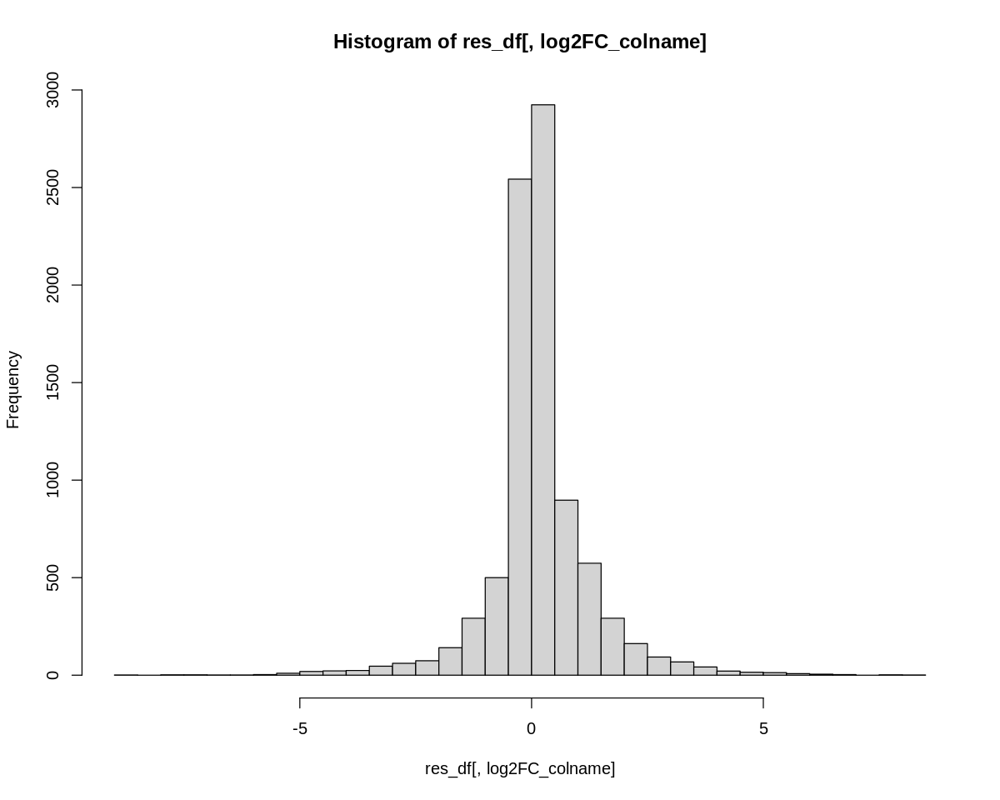

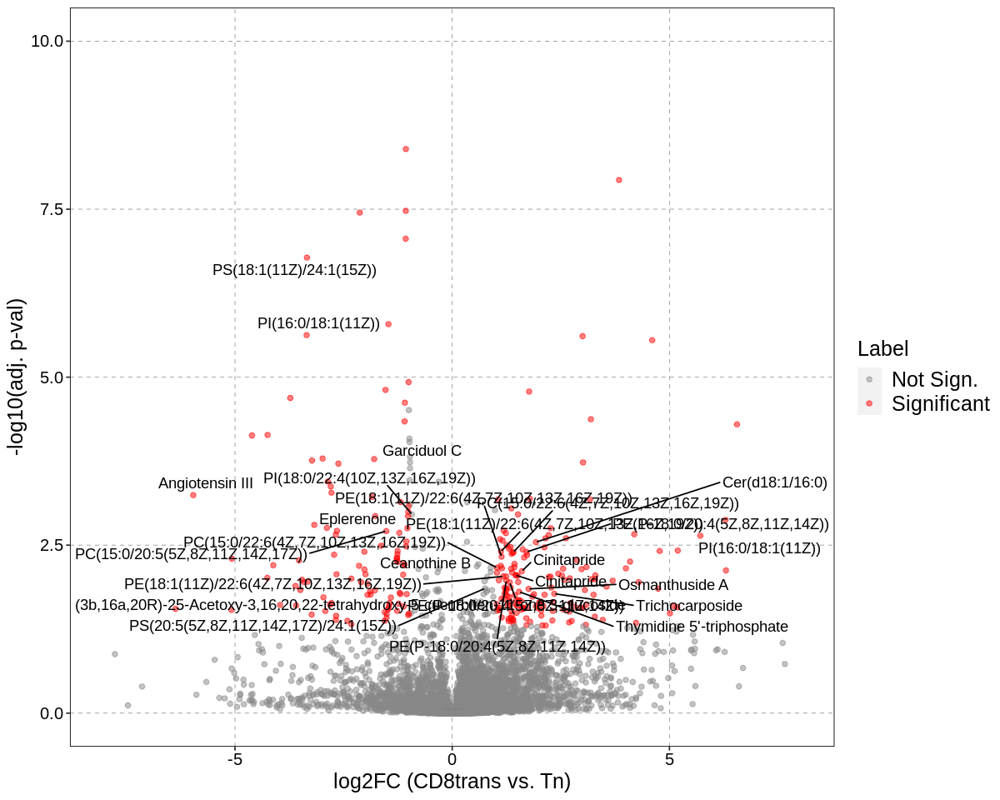

In [37]:
volcano_plot(   res_df = res_df,
                padj_colname = padj_colname,
                log2FC_colname = log2FC_colname,
                p_cut_off = 0.05,
                log2FC_cut_off = 1,
                xlab = glue("log2FC ({contrast})"),
                ylab = '-log10(adj. p-val)',
                xlim = c(-8,8),
                ylim = c(0,10),
                highlight_text = TRUE,
                fig_width = 10,
                fig_height = 8,
                text_size = 12,
                legend_size = 15,
                axis_title_size = 15,
                output_dir = out_dir,
                pdf_prefix = glue('{contrast}_with_highlight{topN}'),
                show_plot = TRUE)

-------

-------

-------

# Volcano plot
## log2FC CD8stem vs. Tn

In [38]:
colnames(res_df)[grep("Tpadj",colnames(res_df))]

[1] "Tpadj_CD8TD.CD8stem"    "Tpadj_CD8trans.CD8stem" "Tpadj_Tn.CD8stem"      
[4] "Tpadj_CD8trans.CD8TD"   "Tpadj_Tn.CD8TD"         "Tpadj_Tn.CD8trans"

In [39]:
colnames(res_df)[grep("log2FC",colnames(res_df))]

[1] "log2FC_CD8stemvsTn"       "log2FC_CD8transvsTn"     
[3] "log2FC_CD8TDvsTn"         "log2FC_CD8transvsCD8stem"
[5] "log2FC_CD8TDvsCD8stem"    "log2FC_CD8TDvsCD8trans"

In [40]:
padj_colname = 'Tpadj_Tn.CD8stem'
log2FC_colname = 'log2FC_CD8stemvsTn'
contrast = "CD8stem vs. Tn"

### With highlight

### Select parameters for highlight

In [41]:
if(want2annotate_feature_name) {
    annot_df = read.csv(annot_file_name, sep = '\t') #somehow only dplyr read.csv works 
    res_df = select_topN2present(res_df, annot_df, topN)
}

Warning message:
“`arrange_()` was deprecated in dplyr 0.7.0.
ℹ Please use `arrange()` instead.
ℹ See vignette('programming') for more help”


In [42]:
want2annotate_feature_name = TRUE
topN = 200

In [43]:
unique(res_df$highlight)

[1] ""                                                                               
 [2] "PS(18:1(11Z)/24:1(15Z))"                                                        
 [3] "PI(16:0/18:1(11Z))"                                                             
 [4] "Garciduol C"                                                                    
 [5] "(3b,16a,20R)-25-Acetoxy-3,16,20,22-tetrahydroxy-5-cucurbiten-11-one 3-glucoside"
 [6] "Eplerenone"                                                                     
 [7] "PI(18:0/22:4(10Z,13Z,16Z,19Z))"                                                 
 [8] "PC(15:0/20:5(5Z,8Z,11Z,14Z,17Z))"                                               
 [9] "Cinitapride"                                                                    
[10] "Thymidine 5'-triphosphate"                                                      
[11] "PE(16:0/22:6(4Z,7Z,10Z,13Z,16Z,19Z))"                                           
[12] "PE(18:1(11Z)/22:6(4Z,7Z,10Z,13Z,16Z,19Z))"                                      
[13] "Ceanothine B"                                                                   
[14] "PC(15:0/18:2(9Z,12Z))"

Warning message in min(x, na.rm = na.rm):
“no non-missing arguments to min; returning Inf”
Warning message in max(x, na.rm = na.rm):
“no non-missing arguments to max; returning -Inf”


[1] "range of log10padj: 0\nrange of log2FC: Inf"                
[2] "range of log10padj: 13.0282473235653\nrange of log2FC: -Inf"
[1] "With highlighted text"


Warning message:
“Removed 23 rows containing missing values (`geom_point()`).”
Warning message:
“Removed 23 rows containing missing values (`geom_point()`).”


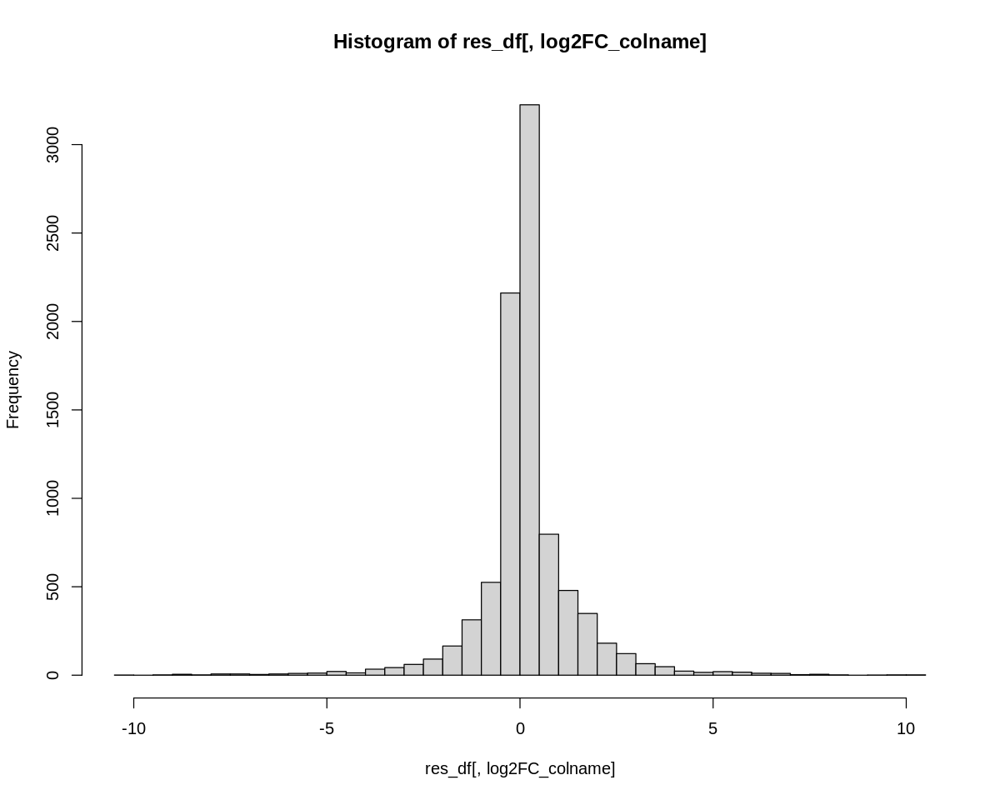

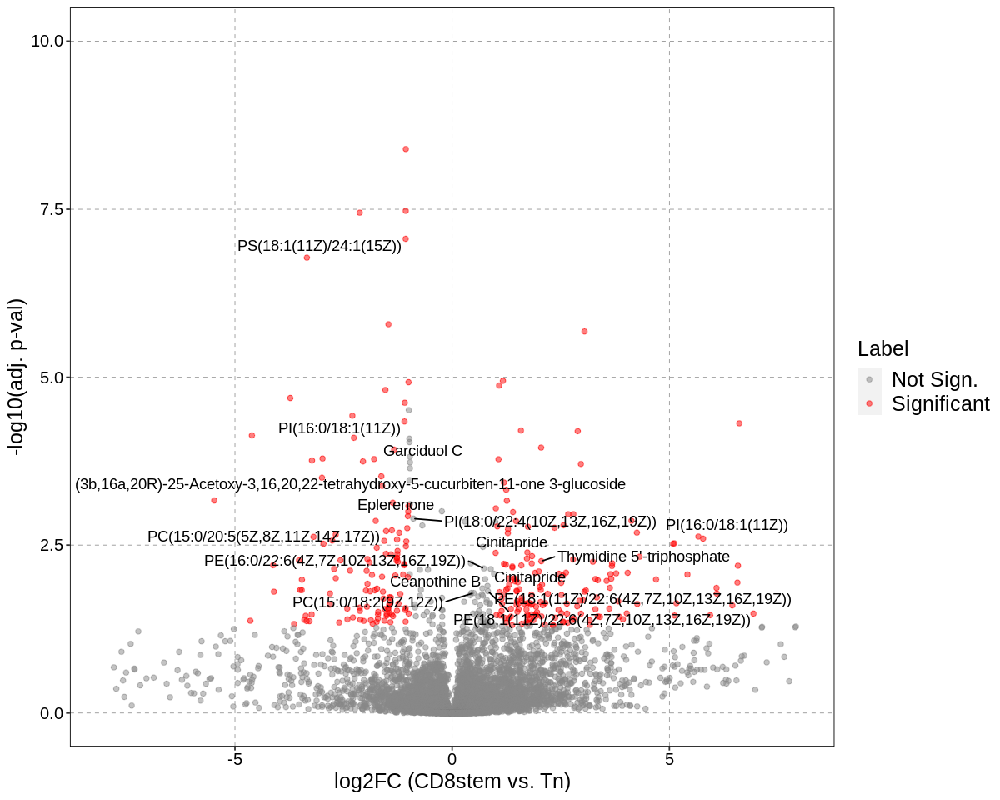

In [44]:
volcano_plot(   res_df = res_df,
                padj_colname = padj_colname,
                log2FC_colname = log2FC_colname,
                p_cut_off = 0.05,
                log2FC_cut_off = 1,
                xlab = glue("log2FC ({contrast})"),
                ylab = '-log10(adj. p-val)',
                xlim = c(-8,8),
                ylim = c(0,10),
                highlight_text = TRUE,
                fig_width = 10,
                fig_height = 8,
                text_size = 12,
                legend_size = 15,
                axis_title_size = 15,
                output_dir = out_dir,
                pdf_prefix = glue('{contrast}_with_highlight{topN}'),
                show_plot = TRUE)

------

------

------

# Volcano plot
## log2FC CD8trans vs. CD8stem

In [45]:
colnames(res_df)[grep("Tpadj",colnames(res_df))]

[1] "Tpadj_CD8TD.CD8stem"    "Tpadj_CD8trans.CD8stem" "Tpadj_Tn.CD8stem"      
[4] "Tpadj_CD8trans.CD8TD"   "Tpadj_Tn.CD8TD"         "Tpadj_Tn.CD8trans"

In [46]:
colnames(res_df)[grep("log2FC",colnames(res_df))]

[1] "log2FC_CD8stemvsTn"       "log2FC_CD8transvsTn"     
[3] "log2FC_CD8TDvsTn"         "log2FC_CD8transvsCD8stem"
[5] "log2FC_CD8TDvsCD8stem"    "log2FC_CD8TDvsCD8trans"

In [47]:
padj_colname = 'Tpadj_CD8trans.CD8stem'
log2FC_colname = 'log2FC_CD8transvsCD8stem'
contrast = "CD8trans vs. CD8stem"

### With highlight

### Select parameters for highlight

In [48]:
if(want2annotate_feature_name) {
    annot_df = read.csv(annot_file_name, sep = '\t') #somehow only dplyr read.csv works 
    res_df = select_topN2present(res_df, annot_df, topN)
}

Warning message:
“`arrange_()` was deprecated in dplyr 0.7.0.
ℹ Please use `arrange()` instead.
ℹ See vignette('programming') for more help”


In [49]:
want2annotate_feature_name = TRUE
topN = 200

In [50]:
unique(res_df$highlight)

[1] ""                                                                                           
 [2] "Angiotensin III"                                                                            
 [3] "PI(16:0/18:1(11Z))"                                                                         
 [4] "(3b,16a,20R)-25-Acetoxy-3,16,20,22-tetrahydroxy-5-cucurbiten-11-one 3-glucoside"            
 [5] "PE(P-18:0/20:4(5Z,8Z,11Z,14Z))"                                                             
 [6] "GlcCer(d18:1/16:0)"                                                                         
 [7] "PE(14:0/20:2(11Z,14Z))"                                                                     
 [8] "PG(18:0/18:1(11Z))"                                                                         
 [9] "PC(15:0/20:5(5Z,8Z,11Z,14Z,17Z))"                                                           
[10] "PS(DiMe(11,3)/DiMe(13,5))"                                                                  
[11] "(1R,3R,4R,5S,6S,8x)-1-Acetoxy-8-angeloyloxy-3,4-epoxy-5-hydroxy-7(14),10-bisaboladien-2-one"
[12] "Cer(d18:1/16:0)"                                                                            
[13] "Squamocin K"                                                                                
[14] "PA(18:3(6Z,9Z,12Z)/20:5(5Z,8Z,11Z,14Z,17Z))"                                                
[15] "PC(15:0/22:4(7Z,10Z,13Z,16Z))"                                                              
[16] "PC(15:0/20:4(5Z,8Z,11Z,14Z))"                                                               
[17] "Valsartan"

Warning message in min(x, na.rm = na.rm):
“no non-missing arguments to min; returning Inf”
Warning message in max(x, na.rm = na.rm):
“no non-missing arguments to max; returning -Inf”


[1] "range of log10padj: 0\nrange of log2FC: Inf"                
[2] "range of log10padj: 11.8232919735934\nrange of log2FC: -Inf"
[1] "With highlighted text"


Warning message:
“Removed 2 rows containing missing values (`geom_point()`).”
Warning message:
“Removed 2 rows containing missing values (`geom_point()`).”


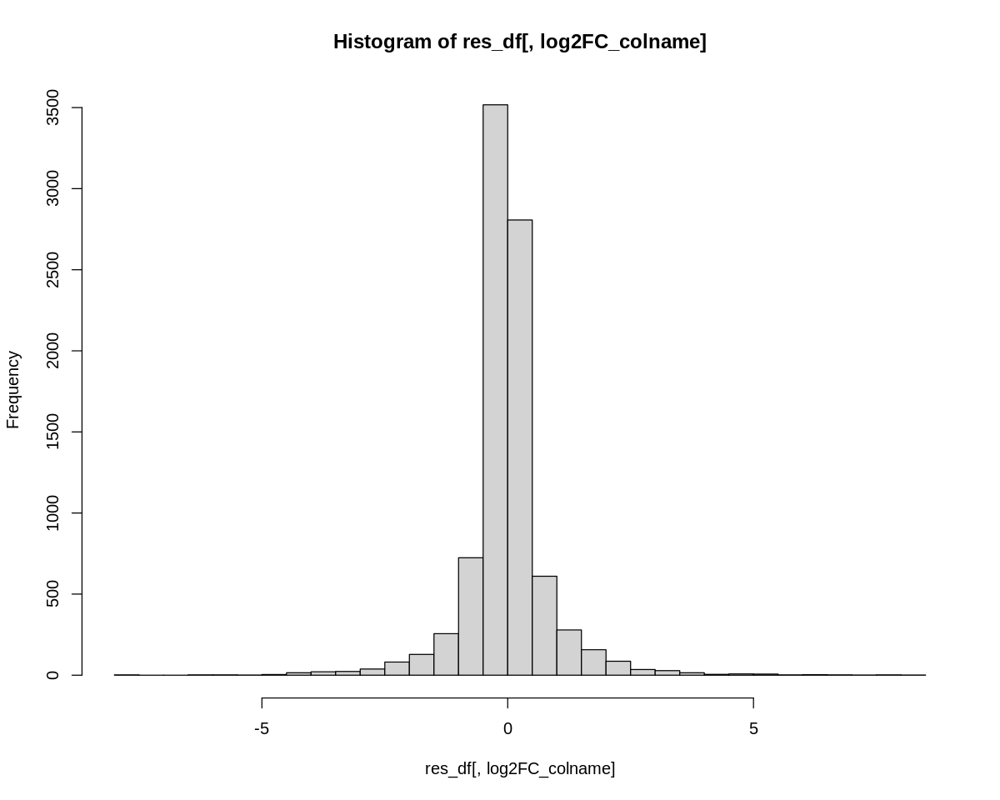

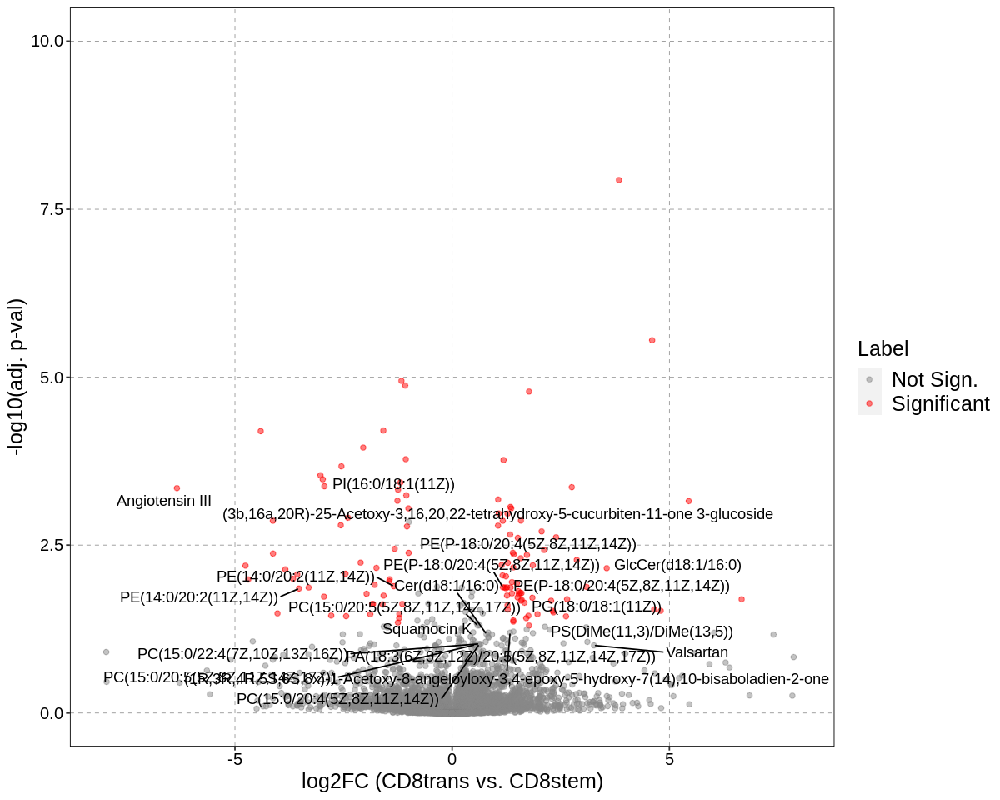

In [51]:
volcano_plot(   res_df = res_df,
                padj_colname = padj_colname,
                log2FC_colname = log2FC_colname,
                p_cut_off = 0.05,
                log2FC_cut_off = 1,
                xlab = glue("log2FC ({contrast})"),
                ylab = '-log10(adj. p-val)',
                xlim = c(-8,8),
                ylim = c(0,10),
                highlight_text = TRUE,
                fig_width = 10,
                fig_height = 8,
                text_size = 12,
                legend_size = 15,
                axis_title_size = 15,
                output_dir = out_dir,
                pdf_prefix = glue('{contrast}_with_highlight{topN}'),
                show_plot = TRUE)